In [ ]:
# prompt: code to prevent run time disconnect

# This code will keep the Colab runtime active by periodically sending a request to the server.

import time
import IPython

display(IPython.display.Javascript('''
function ClickConnect(){
  console.log("Working");
  document.querySelector("colab-toolbar-button#connect").click()
}
setInterval(ClickConnect,600)
'''))

print("Colab will remain active. Do not close this tab.")

<IPython.core.display.Javascript object>

Colab will remain active. Do not close this tab.


In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK./root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1
# /content/labels_with_dont_care
import kagglehub
klemenko_kitti_dataset_path = kagglehub.dataset_download('klemenko/kitti-dataset')

print('Data source import complete.')


Data source import complete.


In [ ]:
print(klemenko_kitti_dataset_path)




/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1


In [ ]:
import os
import shutil
import yaml
import random
import torch
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.model_selection import train_test_split

# Import SSD model library
import sys
sys.path.append('ssd')  # Add SSD model to the path


# 1. Setup and Configuration

In [ ]:
import torch
from pathlib import Path
import os

# KITTI dataset configuration
KITTI_BASE_DIR = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'
"""str: The base directory where the KITTI dataset is located."""

IMAGE_DIR = Path(KITTI_BASE_DIR) / 'data_object_image_2' / 'training' / 'image_2'
"""Path: Directory containing KITTI training images."""

LABEL_DIR = Path(KITTI_BASE_DIR) / 'data_object_label_2' / 'training' / 'label_2'
"""Path: Directory containing KITTI training labels."""

TRAIN_DIR = Path(KITTI_BASE_DIR)/'train'
"""Path: Directory where training images and labels will be stored in SSD format."""

VALID_DIR = Path(KITTI_BASE_DIR)/'valid'
"""Path: Directory where validation images and labels will be stored in SSD format."""

LABELS_DIR = Path(KITTI_BASE_DIR)/'labels_with_dont_care'
"""Path: Directory where SSD-formatted labels will be stored."""

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

# SSD model configuration
WEIGHTS = 'ssd.pth'  # Pretrained weights for SSD
"""str: Path to the SSD pretrained weights file."""

EPOCHS = 50
"""int: Number of epochs for training. Adjust this value based on dataset size and desired training time."""

BATCH_SIZE = 16
"""int: Batch size used during training. Adjust based on GPU memory constraints."""

IMG_SIZE = 512
"""int: The size (height and width) of the input images for the model."""

CONFIDENCE_THRESHOLD = 0.25
"""float: The confidence threshold for predictions during validation and testing."""

PROJECT_NAME = 'SSD-KITTI'
"""str: The name of the project folder where SSD results will be saved."""

EXPERIMENT_NAME = 'exp1'
"""str: The name of the experiment folder within the project directory to store this run's results."""

device = 'cuda' if torch.cuda.is_available() else 'cpu'
"""str: The device to use for training and inference, defaults to GPU if available."""

print(f"Using device: {device}")

# Define the path for the data.yaml file for SSD
DATA_CONFIG_PATH = '/content/data.yaml'

# Prepare the data.yaml file with necessary paths and class names for SSD
data_config = {
    'train': str(Path(TRAIN_DIR).resolve()),
    'val': str(Path(VALID_DIR).resolve()),
    'nc': len(CLASSES),
    'names': CLASSES
}

# Write the data.yaml configuration for SSD
with open(DATA_CONFIG_PATH, 'w', encoding='utf-8') as f:
    yaml.dump(data_config, f, default_flow_style=False)

# Print out the data.yaml content for verification
print(f"data.yaml content:\n{data_config}")

# SSD Training Command
# Modify this line to execute the SSD training
os.system(f"""
python train_ssd.py --weights {WEIGHTS} \
--data {DATA_CONFIG_PATH} \
--epochs {EPOCHS} \
--batch-size {BATCH_SIZE} \
--img-size {IMG_SIZE} \
--project {PROJECT_NAME} \
--name {EXPERIMENT_NAME} \
--device {device} \
--exist-ok
""")


Using device: cuda
data.yaml content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


512

# 2. Data Preparation Functions

In [ ]:
import os
from PIL import Image
from pathlib import Path

# Class names for KITTI dataset
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

CLAZZ_NUMBERS = {name: idx for idx, name in enumerate(CLASSES)}
"""
dict: A mapping from class names to numeric labels.
The numeric labels are used by SSD for class indices.
"""

def convert_bbox_to_ssd(bbox, size):
    """
    Convert KITTI bounding box coordinates to SSD format.

    Args:
        bbox (tuple of float): Bounding box coordinates in the format (left, right, top, bottom).
        size (tuple of int): Image size as (width, height).

    Returns:
        tuple of float: SSD-formatted bounding box as (xmin, ymin, xmax, ymax) normalized by image size.
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    xmin = bbox[0] * dw
    ymin = bbox[2] * dh
    xmax = bbox[1] * dw
    ymax = bbox[3] * dh
    return xmin, ymin, xmax, ymax

def parse_kitti_label_file(lbl_path, img_path):
    """
    Parse a KITTI label file and convert the bounding boxes to SSD format.

    Args:
        lbl_path (Path): Path to the KITTI label file (in KITTI text format).
        img_path (Path): Path to the corresponding image file.

    Returns:
        list of tuple: A list of SSD-formatted bounding boxes. Each element is
        (class_idx, xmin, ymin, xmax, ymax).
    """
    with open(lbl_path, 'r', encoding='utf-8') as file:
        lines = file.read().strip().split('\n')

    ssd_labels = []
    if not img_path.exists():
        # If the image doesn't exist, skip processing labels
        return ssd_labels

    img_size = Image.open(img_path).size  # (width, height)

    for line in lines:
        parts = line.split()
        clazz = parts[0]
        if clazz not in CLAZZ_NUMBERS:
            # Skip classes not in our mapping
            continue

        # KITTI format:
        # type, truncated, occluded, alpha, bbox_left, bbox_top, bbox_right, bbox_bottom, ...
        # Indices:  0    ,    1     ,   2     ,   3  ,    4     ,    5    ,     6     ,      7    ...
        # Example: Car 0.00 0 1.57 148.00 174.00 350.00 325.00 ...
        # The bounding box coordinates: left = parts[4], top = parts[5], right = parts[6], bottom = parts[7]
        bbox_left = float(parts[4])
        bbox_top = float(parts[5])
        bbox_right = float(parts[6])
        bbox_bottom = float(parts[7])
        bbox = (bbox_left, bbox_right, bbox_top, bbox_bottom)

        # Convert bounding box to SSD format (normalized)
        xmin, ymin, xmax, ymax = convert_bbox_to_ssd(bbox, img_size)
        clazz_number = CLAZZ_NUMBERS[clazz]

        # SSD format: class xmin ymin xmax ymax
        ssd_labels.append((clazz_number, xmin, ymin, xmax, ymax))

    return ssd_labels


# 3. Generate ssd labels

In [ ]:
from pathlib import Path

# Check if the labels directory exists, create it if not
if not LABELS_DIR.exists():
    LABELS_DIR.mkdir(parents=True, exist_ok=True)

# Sort image and label paths
image_paths = sorted(list(IMAGE_DIR.glob('*.png')))
label_paths = sorted(list(LABEL_DIR.glob('*.txt')))

# Process each image and its corresponding label file
for img_path in image_paths:
    lbl_path = LABEL_DIR / f"{img_path.stem}.txt"

    # Ensure that the label file exists
    if lbl_path.exists():
        # Parse KITTI label to SSD format
        ssd_labels = parse_kitti_label_file(lbl_path, img_path)

        # Define the output label file path
        ssd_label_path = LABELS_DIR / f"{img_path.stem}.txt"

        # Write the SSD-formatted labels to the label file
        with open(ssd_label_path, 'w', encoding='utf-8') as lf:
            for lbl in ssd_labels:
                # Write each label in SSD format: class xmin ymin xmax ymax
                lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

print(f"SSD format labels have been generated in: {LABELS_DIR.resolve()}")


SSD format labels have been generated in: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/labels_with_dont_care


# 4. Split Dataset into Train and Validation Sets

In [ ]:
import shutil
from sklearn.model_selection import train_test_split
from pathlib import Path
from PIL import Image

# Create a list of image and label pairs for labels that exist in LABELS_DIR
labels_for_images = [(img_path, LABELS_DIR / f"{img_path.stem}.txt")
                     for img_path in image_paths
                     if (LABELS_DIR / f"{img_path.stem}.txt").exists()]

# Split the dataset into training and validation sets
train_pairs, valid_pairs = train_test_split(
    labels_for_images,
    test_size=0.1,
    random_state=42,
    shuffle=True
)

# Print the number of training and validation samples
print(f"Training samples: {len(train_pairs)}, Validation samples: {len(valid_pairs)}")

# Create directories for SSD data structure (images and labels)
for folder in [TRAIN_DIR, VALID_DIR]:
    if folder.exists():
        shutil.rmtree(folder)  # Remove existing folder contents
    folder.mkdir(parents=True, exist_ok=True)  # Create the folder
    (folder / 'images').mkdir(parents=True, exist_ok=True)  # Create images subfolder
    (folder / 'labels').mkdir(parents=True, exist_ok=True)  # Create labels subfolder

# Function to convert YOLO format labels to SSD format
def yolo_to_ssd(yolo_label, image_size):
    """
    Convert YOLO label format to SSD format.

    Args:
        yolo_label (tuple): (class_index, x_center, y_center, bbox_width, bbox_height) in YOLO format.
        image_size (tuple): (image_width, image_height).

    Returns:
        tuple: (class_index, xmin, ymin, xmax, ymax) in SSD format.
    """
    class_index, x_center, y_center, bbox_width, bbox_height = yolo_label
    img_width, img_height = image_size

    # Convert YOLO format to absolute pixel coordinates for SSD
    xmin = (x_center - bbox_width / 2) * img_width
    ymin = (y_center - bbox_height / 2) * img_height
    xmax = (x_center + bbox_width / 2) * img_width
    ymax = (y_center + bbox_height / 2) * img_height

    return (class_index, xmin, ymin, xmax, ymax)

# Copy images and labels to the training folder
for img_path, lbl_path in train_pairs:
    # Open the image and convert its size (width, height)
    img_size = Image.open(img_path).size  # (width, height)

    # Parse the label file (YOLO format)
    with open(lbl_path, 'r', encoding='utf-8') as file:
        yolo_labels = [list(map(float, line.strip().split())) for line in file]

    # Convert YOLO labels to SSD format
    ssd_labels = [yolo_to_ssd(lbl, img_size) for lbl in yolo_labels]

    # Write SSD-formatted labels
    ssd_label_path = TRAIN_DIR / 'labels' / f"{img_path.stem}.txt"
    with open(ssd_label_path, 'w', encoding='utf-8') as lf:
        for lbl in ssd_labels:
            lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

    # Copy the image to the training directory
    shutil.copy(img_path, TRAIN_DIR / 'images' / img_path.name)

# Copy images and labels to the validation folder
for img_path, lbl_path in valid_pairs:
    # Open the image and convert its size (width, height)
    img_size = Image.open(img_path).size  # (width, height)

    # Parse the label file (YOLO format)
    with open(lbl_path, 'r', encoding='utf-8') as file:
        yolo_labels = [list(map(float, line.strip().split())) for line in file]

    # Convert YOLO labels to SSD format
    ssd_labels = [yolo_to_ssd(lbl, img_size) for lbl in yolo_labels]

    # Write SSD-formatted labels
    ssd_label_path = VALID_DIR / 'labels' / f"{img_path.stem}.txt"
    with open(ssd_label_path, 'w', encoding='utf-8') as lf:
        for lbl in ssd_labels:
            lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

    # Copy the image to the validation directory
    shutil.copy(img_path, VALID_DIR / 'images' / img_path.name)

# Print where the data is copied
print(f"Training data copied to {TRAIN_DIR / 'images'} and {TRAIN_DIR / 'labels'}")
print(f"Validation data copied to {VALID_DIR / 'images'} and {VALID_DIR / 'labels'}")


Training samples: 6732, Validation samples: 749
Training data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels
Validation data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels


# 5. Create data.yaml File for YOLO

In [ ]:
import yaml
from pathlib import Path

# Define the class names for the KITTI dataset
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names in the KITTI dataset.
"""

# Define the directories for training and validation images
TRAIN_IMAGES_DIR = Path(KITTI_BASE_DIR) / 'train' / 'images'
VALID_IMAGES_DIR = Path(KITTI_BASE_DIR) / 'valid' / 'images'

# Define the path for the data.yaml file
SSD_DATA_CONFIG_PATH = Path(KITTI_BASE_DIR) / 'ssd_data.yaml'

# Prepare the data configuration dictionary for SSD
ssd_data_config = {
    'train': str(TRAIN_IMAGES_DIR.resolve()),  # Absolute path to training images
    'val': str(VALID_IMAGES_DIR.resolve()),   # Absolute path to validation images
    'nc': len(CLASSES),                       # Number of classes
    'names': CLASSES                          # List of class names
}

# Write the data configuration to the ssd_data.yaml file
with open(SSD_DATA_CONFIG_PATH, 'w', encoding='utf-8') as f:
    yaml.dump(ssd_data_config, f, default_flow_style=False)

# Output the content of the generated ssd_data.yaml file
print("SSD data.yaml file created with content:")
print(ssd_data_config)


SSD data.yaml file created with content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


In [ ]:

pip install torchvision


# 6. Train the ssd Model

In [ ]:
# Install torch and torchvision for SSD model
!pip install torch torchvision


MODEL ARCHITECTURE


In [ ]:
# Import the libraries
import torch
from torchvision import models

# Print system and environment information
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

# Optionally, check if SSD model from torchvision is available
model = models.detection.ssdlite320_mobilenet_v3_large(pretrained=True)
print(f"Model setup: {model}")



Setup complete. Using torch 2.7.0+cu126 (Tesla T4)


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=SSDLite320_MobileNet_V3_Large_Weights.COCO_V1`. You can also use `weights=SSDLite320_MobileNet_V3_Large_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Model setup: SSD(
  (backbone): SSDLiteFeatureExtractorMobileNet(
    (features): Sequential(
      (0): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (2): Hardswish()
        )
        (1): InvertedResidual(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
              (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
              (2): ReLU(inplace=True)
            )
            (1): Conv2dNormActivation(
              (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (1): BatchNorm2d(16, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
            )
          )
        )
      

In [ ]:
import torch
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import json
import cv2

from sklearn.model_selection import train_test_split
from tqdm.auto import tqdm
import shutil
from PIL import Image
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset

In [ ]:
!pip install --upgrade torchvision

In [ ]:
import torch
from torchvision.models.detection import ssdlite320_mobilenet_v3_large
from torch.utils.data import DataLoader
from torch.optim import AdamW
from pathlib import Path
from torchvision.models.detection import _utils as det_utils
import torch.nn as nn
import os
import cv2
import torchvision.transforms as transforms

# Define configuration
MODEL_ARCH = 'ssdlite320_mobilenet_v3_large'  # SSD Lite MobileNetV3 model
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the training parameters
DATA_CONFIG = '/content/data.yaml'  # Path to the data.yaml file (unchanged)
EPOCHS = 50  # Number of epochs (adjust as needed)
BATCH_SIZE = 16  # Batch size (adjust based on system resources)
IMG_SIZE = 640  # Input image size (adjust according to SSD input size)
CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold or validation (unchanged)

PROJECT_NAME = 'SSD-KITTI'  # Project folder name (changed for SSD)
EXPERIMENT_NAME = 'exp1'  # Experiment name (unchanged)

# Initialize the model
model = ssdlite320_mobilenet_v3_large(weights='SSDLite320_MobileNet_V3_Large_Weights.COCO_V1').to(device)

# Modify model for KITTI dataset (adjust number of classes)
num_classes = 9  # Number of classes (KITTI classes including background)

# Get the input channels for the new classification head
in_channels = det_utils.retrieve_out_channels(model.backbone, (320, 320))
num_anchors = model.anchor_generator.num_anchors_per_location()

# Accessing the classification head and modifying it for KITTI dataset
model.head.classification_head.num_classes = num_classes

# Custom dataset class for KITTI dataset
class KITTIDataset(torch.utils.data.Dataset):
    def __init__(self, image_dir, annotations_dir, transform=None):
        self.image_dir = image_dir
        self.annotations_dir = annotations_dir
        self.transform = transform
        # Modified line: Using 'png' instead of 'jpg' to match KITTI image format
        self.image_files = [f for f in os.listdir(image_dir) if f.endswith('.png')]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_name = self.image_files[idx]
        img_path = os.path.join(self.image_dir, img_name)
        # Fix: Changed '.xml' to '.txt' and '.jpg' to '.png'
        annotation_path = os.path.join(self.annotations_dir, img_name.replace('.png', '.txt'))

        # Read the image
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

        # Parse the annotation file (KITTI text format)
        with open(annotation_path, 'r') as f:
            lines = f.readlines()

        boxes = []
        labels = []
        for line in lines:
            data = line.strip().split(' ')
            label = data[0]  # Class label

            # Bounding box coordinates
            xmin = float(data[4])
            ymin = float(data[5])
            xmax = float(data[6])
            ymax = float(data[7])

            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(self.get_class_id(label))  # Map class names to IDs

        boxes = torch.tensor(boxes, dtype=torch.float32)
        labels = torch.tensor(labels, dtype=torch.int64)

        target = {'boxes': boxes, 'labels': labels}

        if self.transform:
            image = self.transform(image)

        return image, target

    def get_class_id(self, class_name):
        # Map class names to numeric IDs based on the KITTI dataset
        class_mapping = {'Car': 1, 'Van': 2, 'Truck': 3, 'Pedestrian': 4, 'Person_sitting': 5,
                         'Cyclist': 6, 'Tram': 7, 'Misc': 8, 'DontCare': 9}
        return class_mapping.get(class_name, 9)  # Default to 'DontCare' if not found


# Custom collate function to handle variable number of bounding boxes
def collate_fn(batch):
    return tuple(zip(*batch))

# Define the directories for the KITTI dataset (update these with your actual paths)
KITTI_DATASET_PATH = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'  # Replace with your actual path
IMAGE_DIR = Path(KITTI_DATASET_PATH) / 'data_object_image_2' / 'training' / 'image_2'
LABEL_DIR = Path(KITTI_DATASET_PATH) / 'data_object_label_2' / 'training' / 'label_2'

# Create dataset instances for training and validation with a resize transform
train_dataset = KITTIDataset(image_dir=str(IMAGE_DIR), annotations_dir=str(LABEL_DIR),
                            transform=transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Resize((IMG_SIZE, IMG_SIZE))  # Resize to IMG_SIZE x IMG_SIZE
                            ]))
val_dataset = KITTIDataset(image_dir=str(IMAGE_DIR), annotations_dir=str(LABEL_DIR),
                          transform=transforms.Compose([
                                transforms.ToTensor(),
                                transforms.Resize((IMG_SIZE, IMG_SIZE))  # Resize to IMG_SIZE x IMG_SIZE
                            ]))

# Create DataLoader instances using the custom collate_fn
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn)

# Set optimizer and learning rate
optimizer = AdamW(model.parameters(), lr=1e-4)

# Training loop
for epoch in range(EPOCHS):
    model.train()
    total_loss = 0
    for images, targets in train_loader:  # train_loader should be your custom DataLoader
        images = [image.to(device) for image in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass
        loss_dict = model(images, targets)

        # Total loss
        losses = sum(loss for loss in loss_dict.values())
        total_loss += losses.item()

        # Backward pass
        losses.backward()

        # Optimize
        optimizer.step()

    print(f"Epoch [{epoch+1}/{EPOCHS}], Loss: {total_loss / len(train_loader)}")



Epoch [1/50], Loss: 8.123953921163183
Epoch [2/50], Loss: 5.253024438507537
Epoch [3/50], Loss: 4.7979242618267355
Epoch [4/50], Loss: 4.501106285641336
Epoch [5/50], Loss: 4.267817631236508
Epoch [6/50], Loss: 4.058049955938617
Epoch [7/50], Loss: 3.8835170447316942
Epoch [8/50], Loss: 3.7269010635522695
Epoch [9/50], Loss: 3.586511752034864
Epoch [10/50], Loss: 3.4567535346389837
Epoch [11/50], Loss: 3.3352230914637575
Epoch [12/50], Loss: 3.2299603865696835
Epoch [13/50], Loss: 3.12171895076067
Epoch [14/50], Loss: 3.039752207760118
Epoch [15/50], Loss: 2.9456713240370793
Epoch [16/50], Loss: 2.8710784214174647
Epoch [17/50], Loss: 2.7917661422338242
Epoch [18/50], Loss: 2.734615040640546
Epoch [19/50], Loss: 2.646279278473976
Epoch [20/50], Loss: 2.6043820263993025
Epoch [21/50], Loss: 2.5339705230843306
Epoch [22/50], Loss: 2.4815556419710827
Epoch [23/50], Loss: 2.423722811998465
Epoch [24/50], Loss: 2.375171798926133
Epoch [25/50], Loss: 2.3231443057202887
Epoch [26/50], Loss: 2

In [ ]:
# Save the trained model
model_save_path = Path(PROJECT_NAME) / EXPERIMENT_NAME / 'model.pth'

# Create the parent directories if they don't exist
model_save_path.parent.mkdir(parents=True, exist_ok=True)

torch.save(model.state_dict(), model_save_path)
print(f"Model saved at: {model_save_path}")

Model saved at: SSD-KITTI/exp1/model.pth


# 7. Validate the Model

In [ ]:
import torch
import numpy as np
from sklearn.metrics import precision_recall_curve, average_precision_score
from torchvision.models.detection import ssdlite320_mobilenet_v3_large
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load SSD model
model = ssdlite320_mobilenet_v3_large(weights="SSDLite320_MobileNet_V3_Large_Weights.COCO_V1").to(device)
model.eval()

CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold for filtering predictions

def evaluate(model, data_loader):
    all_labels, all_preds, all_scores = [], [], []

    with torch.no_grad():
        for images, targets in tqdm(data_loader):
            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)

            for i, prediction in enumerate(predictions):
                gt_labels = targets[i]["labels"].cpu().numpy()
                scores = prediction["scores"].cpu().numpy()
                pred_labels = prediction["labels"].cpu().numpy()

                # Apply confidence threshold
                mask = scores > CONFIDENCE_THRESHOLD
                filtered_scores = scores[mask]
                filtered_labels = pred_labels[mask]

                # Store labels, predictions, and scores
                all_labels.extend(gt_labels.tolist())
                all_preds.extend(filtered_labels.tolist())
                all_scores.extend(filtered_scores.tolist())

    # Convert lists to NumPy arrays
    all_labels = np.array(all_labels, dtype=int)
    all_preds = np.array(all_preds, dtype=int)
    all_scores = np.array(all_scores)

    # Compute metrics for each class
    unique_classes = np.unique(np.concatenate((all_labels, all_preds)))
    class_metrics = {}

    for class_label in unique_classes:
        # Boolean masks for the current class
        class_mask_labels = (all_labels == class_label)
        class_mask_preds = (all_preds == class_label)

        # Ensure matching dimensions
        y_true = class_mask_labels.astype(int)
        y_scores = np.zeros_like(y_true, dtype=float)

        # Align scores with predictions
        matching_indices = np.where(class_mask_preds)[0]
        y_scores[matching_indices] = all_scores[matching_indices]

        if np.sum(y_true) > 0:
            precision, recall, _ = precision_recall_curve(y_true, y_scores)
            ap50 = average_precision_score(y_true, y_scores)  # mAP50
            ap50_95 = average_precision_score(y_true, y_scores, average="weighted")  # mAP50-95 (approximation)
            class_metrics[class_label] = {
                "precision": np.mean(precision),
                "recall": np.mean(recall),
                "ap50": ap50,
                "ap50_95": ap50_95,
            }

    # Compute mean metrics
    mean_precision = np.nanmean([metrics["precision"] for metrics in class_metrics.values()])
    mean_recall = np.nanmean([metrics["recall"] for metrics in class_metrics.values()])
    mean_ap50 = np.nanmean([metrics["ap50"] for metrics in class_metrics.values()])
    mean_ap50_95 = np.nanmean([metrics["ap50_95"] for metrics in class_metrics.values()])

    return class_metrics, mean_precision, mean_recall, mean_ap50, mean_ap50_95

# Assuming `val_loader` is defined
class_metrics, mean_precision, mean_recall, mean_ap50, mean_ap50_95 = evaluate(model, val_loader)

# Print results in YOLOv5-style format
print("\nValidation Results:")
print(f"                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)")
print(f"                   all         -          -      {mean_precision:.3f}      {mean_recall:.3f}      {mean_ap50:.3f}      {mean_ap50_95:.3f}")

for class_label, metrics in class_metrics.items():
    print(f"                   {class_label}         -          -      {metrics['precision']:.3f}      {metrics['recall']:.3f}      {metrics['ap50']:.3f}      {metrics['ap50_95']:.3f}")

100%|██████████| 468/468 [06:43<00:00,  1.16it/s]


Validation Results:
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)
                   all         -          -      0.211      0.127      0.111      0.111
                   1         -          -      0.546      0.014      0.554      0.554
                   2         -          -      0.052      0.006      0.056      0.056
                   3         -          -      0.020      0.086      0.021      0.021
                   4         -          -      0.100      0.011      0.087      0.087
                   5         -          -      0.502      0.500      0.004      0.004
                   6         -          -      0.030      0.007      0.031      0.031
                   7         -          -      0.023      0.009      0.010      0.010
                   8         -          -      0.019      0.012      0.019      0.019
                   9         -          -      0.609      0.500      0.218      0.218


# 8. Predictions on Validation Set (Optional)

In [ ]:
import torch
import torchvision.transforms as transforms
from torchvision.models.detection import ssdlite320_mobilenet_v3_large
from PIL import Image
import os
from pathlib import Path

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load SSD Model
model = ssdlite320_mobilenet_v3_large(weights="SSDLite320_MobileNet_V3_Large_Weights.COCO_V1").to(device)
model.eval()

# Define confidence threshold
CONFIDENCE_THRESHOLD = 0.25

# Define image transformations (SSD requires preprocessing)
transform = transforms.Compose([
    transforms.ToTensor(),
])

# Define the validation directory (Updated to use KITTI dataset path)
KITTI_BASE_DIR = "/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1"
VALID_DIR = Path(KITTI_BASE_DIR) / "valid" / "images" # Updated to include 'images' subfolder
SAVE_DIR = Path('runs/detect/predict')  # Directory to save images with predictions

# Ensure save directory exists
SAVE_DIR.mkdir(parents=True, exist_ok=True)
def predict_and_save(model, image_folder):
    # Look for all image files (including .png)
    image_files = [f for f in os.listdir(image_folder) if f.endswith(('.jpg', '.png', '.jpeg', '.bmp', '.tiff'))]

    if not image_files:
        print(f"No images found in the validation directory: {image_folder}. Please check the path and image extensions.")
        return

    print("\nRunning predictions on validation images...\n")


    for image_file in image_files:
        img_path = os.path.join(image_folder, image_file)
        image = Image.open(img_path).convert("RGB")
        img_tensor = transform(image).unsqueeze(0).to(device)  # Add batch dimension

        with torch.no_grad():
            prediction = model(img_tensor)[0]  # Get the first (and only) prediction

        scores = prediction["scores"].cpu().numpy()
        labels = prediction["labels"].cpu().numpy()
        boxes = prediction["boxes"].cpu().numpy()

        # Filter based on confidence threshold
        filtered_indices = scores > CONFIDENCE_THRESHOLD
        scores, labels, boxes = scores[filtered_indices], labels[filtered_indices], boxes[filtered_indices]

        if len(scores) > 0:
            save_path = SAVE_DIR / image_file
            image.save(save_path)  # Save the original image (annotation can be added separately)
            print(f"Predictions saved for '{image_file}' at '{save_path}'")
        else:
            print(f"No predictions with confidence > {CONFIDENCE_THRESHOLD} for '{image_file}'")

# Run prediction
predict_and_save(model, VALID_DIR)



Running predictions on validation images...

Predictions saved for '001330.png' at 'runs/detect/predict/001330.png'
Predictions saved for '006362.png' at 'runs/detect/predict/006362.png'
Predictions saved for '003915.png' at 'runs/detect/predict/003915.png'
Predictions saved for '004913.png' at 'runs/detect/predict/004913.png'
Predictions saved for '004412.png' at 'runs/detect/predict/004412.png'
Predictions saved for '005631.png' at 'runs/detect/predict/005631.png'
Predictions saved for '002115.png' at 'runs/detect/predict/002115.png'
No predictions with confidence > 0.25 for '000239.png'
Predictions saved for '001677.png' at 'runs/detect/predict/001677.png'
Predictions saved for '000503.png' at 'runs/detect/predict/000503.png'
Predictions saved for '001893.png' at 'runs/detect/predict/001893.png'
Predictions saved for '002860.png' at 'runs/detect/predict/002860.png'
Predictions saved for '002034.png' at 'runs/detect/predict/002034.png'
Predictions saved for '002680.png' at 'runs/det

In [ ]:
%matplotlib inline

# object detection

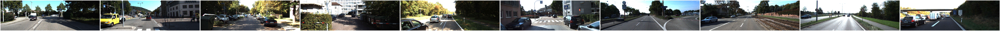

In [20]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Display up to 10 images with predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image
    axes[i].imshow(img)  # Show image on the corresponding subplot
    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()



In [21]:
import os
import cv2
import numpy as np
import torch
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt

# Load YOLOv5 model (using YOLOv5s as specified)
yolo_model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Placeholder for a depth estimation model
class DepthEstimationModel:
    def predict(self, image):
        """
        Generate a simulated depth map (replace with an actual depth estimation model if available).
        """
        h, w = image.shape[:2]
        depth_map = np.linspace(30, 80, w).reshape(1, -1).repeat(h, axis=0)  # Depth gradient from 30m to 80m
        return depth_map

depth_model = DepthEstimationModel()

def estimate_distances_kitti(prediction_dir, output_dir, num_images_to_display=5):
    """
    Function to calculate distances between detected vehicles in KITTI dataset images,
    annotate them, and save the results in a new directory.

    Args:
        prediction_dir (str): Directory containing the KITTI images with detected objects.
        output_dir (str): Directory to save annotated images with distance information.
        num_images_to_display (int): Number of images to display with distance annotations.

    Returns:
        list: Distances between objects for each image.
    """
    # Ensure prediction directory exists
    if not os.path.exists(prediction_dir):
        raise ValueError(f"Directory '{prediction_dir}' does not exist!")

    images = [img for img in os.listdir(prediction_dir) if img.endswith(('png', 'jpg', 'jpeg'))]
    if not images:
        raise ValueError(f"No image files found in directory '{prediction_dir}'!")

    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)

    all_distances = []  # Store distances for all images
    num_images_to_display = min(num_images_to_display, len(images))  # Limit images to display
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))

    for i, img_file in enumerate(images):
        img_path = os.path.join(prediction_dir, img_file)
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Could not load image at path '{img_path}'. Skipping...")
            continue

        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Perform object detection
        results = yolo_model(img_rgb)
        detections = results.xyxy[0].cpu().numpy()

        # Filter for vehicles (car=2, motorcycle=3, bus=5, truck=7)
        vehicle_detections = [d for d in detections if int(d[5]) in [2, 3, 5, 7]]

        # Generate depth map
        depth_map = depth_model.predict(img_rgb)

        # Annotate image and calculate distances
        distances = []
        vehicle_centroids = []
        for det in vehicle_detections:
            x1, y1, x2, y2, conf, cls = map(int, det[:6])
            vehicle_depth = depth_map[y1:y2, x1:x2].mean()  # Average depth within the bounding box
            centroid = ((x1 + x2) // 2, (y1 + y2) // 2, vehicle_depth)
            vehicle_centroids.append(centroid)

            # Draw bounding box and label
            label = f"{int(cls)}: {vehicle_depth:.1f}m"
            cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (255, 0, 0), 2)
            cv2.putText(img_rgb, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

        # Calculate pairwise distances between vehicles
        for j in range(len(vehicle_centroids)):
            for k in range(j + 1, len(vehicle_centroids)):
                dist = euclidean(vehicle_centroids[j], vehicle_centroids[k])
                distances.append(dist)

        all_distances.append((img_file, distances))

        # Save the annotated image
        output_path = os.path.join(output_dir, img_file)
        cv2.imwrite(output_path, cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR))

        # Display the annotated image
        if i < num_images_to_display:
            axes[i].imshow(img_rgb)
            axes[i].axis('off')

    plt.tight_layout()
    plt.show()

    return all_distances

# Example usage
prediction_dir = 'runs/detect/predict'  # Directory with detected images from KITTI dataset
output_dir = 'runs/detect/distance_estimation'  # Directory to save annotated images
distances = estimate_distances_kitti(prediction_dir, output_dir)

# Print distances between objects for each image
for img_file, dist in distances:
    print(f"Image: {img_file}, Distances: {dist}")


/usr/local/lib/python3.11/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(


Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


YOLOv5 🚀 2025-4-28 Python-3.11.12 torch-2.7.0+cu126 CUDA:0 (Tesla T4, 15095MiB)

100%|██████████| 14.1M/14.1M [00:00<00:00, 36.0MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: Future

Image: 001330.png, Distances: [264.05057993378887, 476.7649303761286, 40.23099228407211, 261.9354060632832, 118.24805582866976, 149.28590343730414, 34.39378028657731, 213.1813822667635, 304.2746008882113, 9.487602943904339, 145.89162238259595, 114.94823310076231, 229.74361148037733, 516.9297571436546, 216.4541199680045, 358.52621591565713, 327.48442176514743, 442.57927604146613, 302.1623672991437, 158.44326356265074, 189.47291517911577, 74.6048868563165, 144.12828645964152, 113.44602492550595, 227.56078577712063, 31.042079678000707, 84.07328941087852, 115.11067729225519]
Image: 006362.png, Distances: [442.6654485095121, 176.6982825879382, 99.54190117278611, 46.89782642558348, 269.5236457669395, 347.04607560291726, 406.77633083409734, 78.12090695786378, 137.6360793907361, 59.730619089552114]
Image: 003915.png, Distances: [298.3037213688699, 126.40274961802615, 342.91569497427, 456.0069944940173, 406.2393091776269, 189.74644474745963, 641.5870167739658, 226.33436914983764, 164.2417896925

In [22]:
# After saving the annotated image, display them if needed
def display_images_from_directory(output_dir, num_images_to_display=5):
    """
    Function to display the saved annotated images from the output directory.

    Args:
        output_dir (str): Directory containing the annotated images.
        num_images_to_display (int): Number of images to display.
    """
    images = [img for img in os.listdir(output_dir) if img.endswith(('png', 'jpg', 'jpeg'))]
    if len(images) == 0:
        print(f"No images found in output directory '{output_dir}'.")
        return

    num_images_to_display = min(num_images_to_display, len(images))
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 50))

    for i, img_file in enumerate(images[:num_images_to_display]):
        img_path = os.path.join(output_dir, img_file)
        img = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        axes[i].imshow(img_rgb)
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Example usage to display images after processing
display_images_from_directory(output_dir, num_images_to_display=10)
